### Team Lead comments

<div class="alert alert-success">
Dear Anton! Thank you so much for an amazing work! It's one of the best I've seen fot this project. High technical execution and approach to the data. You're clearly one of the strongest student! Congratulations :)
</div>

### Final Project. Telecom

This is work of Anton Rubenchik anton.rubenchik@gmail.com

##### Table of contents
[Introduction](#introduction)
1. [Download the data and prepare it for analysis.](#prepare)<br />
2. [Data preprocessing](#data_preprocessing)<br />
2.1 [Find duplicates and missing values](#duplicates)<br />
2.2 [Study incorrect value:](#incorrect)<br />
2.2.1 [The total call duration is less than the talk time](#call_duration)<br />
2.2.2 [Call duration](#call_duration2)<br />
2.2.3 [Combining data.](#combining)<br />
3. [Exploratory data analysis.](#eda)<br />
3.1 [How many customers use this service?](#3_1)<br />
3.2 [Plot distributions of the number of operators by clients.](#3_2)<br />
3.3 [Plot a graph of the distribution of the number of calls by operators.](#3_3)<br />
3.4 [Plot distributions of calls duration by day by operator](#3_4)<br />
3.5 [Plot distributions of call duration](#3_5)<br />
3.6 [Study the share of calls(internal/external, incoming/outgoing).](#3_6)<br />
3.7 [Study the share of missing calls.](#3_7)<br />
4. [Divide operators into effective/ineffective](#4)<br />
4.1 [Divide operators into types.](#4_1)<br />
4.2 [The proportions of the types of operators.](#4_2)<br />
4.3  [Study the characteristics by which we can evaluate the operator's efficiency](#4_3)<br />
4.3.1 [Plot distributions of the number of outgoing calls for Type B operator per day](#4_3_1)<br />
4.3.2 [Plot distributions of the duration calls for Type B operator.](#4_3_2)<br />
4.3.3. [Plot distribution of calls duration for type B operator. (min).](#4_3_3)<br />
4.3.4 [The proportion of missed incoming calls for operators of type C](#4_3_4)<br />
4.3.5 [Distribution, the number of missed calls per day among operators of type C.](#4_3_5)<br />
4.3.6 [Plot distributions of waiting time for Type C operators.](#4_3_6)<br />
4.4. [Define the effective/ineffective operator thresholds for each type.](#4_4)<br />
4.5 [Assign a rating to the operator. (effective/ineffective)](#4_5)<br />
5. [Test the following hypotheses](#hypotheses)<br />
5.1 [Hypothese I. The number of missed calls on weekends is higher than on weekdays.](#hypotheses_1)<br />
5.2 [Hypothese II. Clients of tariff plan "B" have more inefficient operators than clients of tariff plan "C".](#hypotheses_2)<br />
6. [Prediction](#prediction)<br />
6.1 [Data preprocessing](#6_1)<br />
6.2 [Let's compare the average values of characteristics in two groups: those who are considered ineffective operators and those who are considered effective.](#6_2)<br />
6.3 [Correlation matrix between customer features](#matrix)<br />
6.4 [Standardize the data and plot a dendrogram](#dendrogram)<br />
6.5 [Let's train the model on the train set with "K-means" algorithm.](#k_means)<br />
6.6 [The mean feature values for clusters.](#mean)<br />
6.7 [Plot distributions of features for the clusters.](#distributions)<br />
6.8 [Calculate the proportion of inefficient operators for each cluster](#calculate)<br />
7.  [Conclusions and basic recommendations](#conclusions)<br />
7.1 [Overall conclusion.](#overall_conclusion)<br />
7.2 [Recommendations.](#recommendations)<br />
[List of references.](#references)<br />
[Dashboard](#dashboard)<br />
[Presentation](#presentation)<br />


### Introduction<br /><a name="introduction"></a>
Task:<br />
The virtual telephony service **CallMeMaybe** is developing a new function that will give supervisors information on the least effective operators. An operator is considered ineffective if they have a large number of missed incoming calls (internal and external) and a long waiting time for incoming calls. Moreover, if an operator is supposed to make outgoing calls, a small number of them is also a sign of ineffectiveness.<br /><br />

I need to process the data and develop an algorithm for evaluating the operator's efficiency.
<br /><br />
Clients of our company are organizations that need to distribute a large number of incoming calls between different operators or make outgoing calls through their operators. Operators can also make internal calls to communicate with each other.

#### Description of the data <br />

Dataset "telecom_dataset_us.csv"
- user_id — client account ID
- date — date the statistics were retrieved
- direction — call direction
- internal — whether the call was internal
- operator_id — operator identifier
- is_missed_call — whether the call was missed
- calls_count — number of calls
- call_duration — call duration (excluding waiting time)
- total_call_duration — call duration (including waiting time)

Dataset "telecom_clients_us.csv"
- user_id — client account ID
- tariff_plan — client's current plan
- date_start — client's registration date

### 1. Download the data and prepare it for analysis.<a name="prepare"></a>

In [1]:
# #code for platform
!pip install --upgrade plotly
import plotly
print(plotly.__version__)

Requirement already up-to-date: plotly in /Applications/anaconda3/envs/practicum/lib/python3.7/site-packages (4.14.3)
4.14.3


In [2]:
import pandas   as pd
from datetime import datetime as dt
# math
import numpy as np
import math
from scipy import stats as st

# graph
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
from plotly import graph_objects as go

#ML
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import StandardScaler 
from scipy.cluster.hierarchy import dendrogram, linkage 
from sklearn.cluster import KMeans 
from sklearn.metrics import silhouette_score

In [3]:
# Constants
pd.options.display.float_format = "{:.2f}".format
pd.set_option('display.max_colwidth', 400)
percentile_dict = [95,98,99]
percentile_dict_25 = [25]
percentile_dict_miss = [75,80,85]
color_dict = ['#00b894','#fdcb6e','#6c5ce7','#d63031','#0984e3','#e84393','#6c5ce7']
color = 'rgb(205, 12, 24)'
colors = ['rgba(93, 164, 214, 0.5)', 'rgba(255, 144, 14, 0.5)', 'rgba(44, 160, 101, 0.5)',
          'rgba(255, 65, 54, 0.5)', 'rgba(207, 114, 255, 0.5)', 'rgba(127, 96, 0, 0.5)']

In [4]:
try:
    operators = pd.read_csv('telecom_dataset_us.csv')
    clients = pd.read_csv('telecom_clients_us.csv')
except:
    operators = pd.read_csv('https://code.s3.yandex.net/datasets/telecom_dataset_us.csv')
    clients = pd.read_csv('https://code.s3.yandex.net/datasets/telecom_clients_us.csv')

### 2. Data preprocessing<a name="data_preprocessing"></a>

##### 2.1 Find duplicates and missing values<a name="duplicates"></a>

operators:

In [5]:
operators.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53902 entries, 0 to 53901
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   user_id              53902 non-null  int64  
 1   date                 53902 non-null  object 
 2   direction            53902 non-null  object 
 3   internal             53785 non-null  object 
 4   operator_id          45730 non-null  float64
 5   is_missed_call       53902 non-null  bool   
 6   calls_count          53902 non-null  int64  
 7   call_duration        53902 non-null  int64  
 8   total_call_duration  53902 non-null  int64  
dtypes: bool(1), float64(1), int64(4), object(3)
memory usage: 3.3+ MB


In [6]:
operators.describe()

,user_id,operator_id,calls_count,call_duration,total_call_duration
count,53902.00,45730.00,53902.00,53902.00,53902.00
mean,167295.34,916535.99,16.45,866.68,1157.13
std,598.88,21254.12,62.92,3731.79,4403.47
min,166377.00,879896.00,1.00,0.00,0.00
25%,166782.00,900788.00,1.00,0.00,47.00
50%,167162.00,913938.00,4.00,38.00,210.00
75%,167819.00,937708.00,12.00,572.00,902.00
max,168606.00,973286.00,4817.00,144395.00,166155.00


In [7]:
display(operators.sample(5))

,user_id,date,direction,internal,operator_id,is_missed_call,calls_count,call_duration,total_call_duration
16453,166916,2019-10-16 00:00:00+03:00,in,False,906412.00,False,1,48,65
25475,167130,2019-09-10 00:00:00+03:00,out,False,902608.00,False,42,2830,3744
4176,166503,2019-10-16 00:00:00+03:00,in,False,906680.00,False,4,324,442
29878,167264,2019-11-14 00:00:00+03:00,in,False,919552.00,False,32,4331,5328
43033,167977,2019-11-11 00:00:00+03:00,out,False,944218.00,True,6,0,96


In [8]:
print('Duplicates found - ',operators.duplicated().sum(),' records')

Duplicates found -  4900  records


##### Conclusion:<br />
After conducting a preliminary analysis, it was found:
 - 4900 duplicate records were found. Need to remove
 - The **operator_id** field contains missing values for **7456** records. Of course, we will not be able to correctly restore these values, but it is also not worth deleting these records, as they will help us conduct EDA and develop criteria for evaluating operators effective/ineffective. Need to replace NaN value with "0"
 - **110** records are missing values in the **internal** field. This is not a key field in assessing the operator's activity, so we will not delete this data either; we will simply exclude these records when assessing the share of internal/external calls.
 - We need to rename the columns to better describe the data.
 - We need to change the data type for the following fields:
   - date (DateTime)
   - operator_id (Int)
   - direction (Bool)
 - As we found out, one entry corresponds to the daily activity of the operator. However, some operators have more than one entry for a specific date. We need to combine the record data.

##### Let's process the data

In [9]:
operators.drop_duplicates(inplace=True)
operators['operator_id'].fillna(0, inplace=True)
operators.rename(columns={'direction':'direction_in',
                          'is_missed_call':'is_missed_calls',
                          'call_duration':'calls_duration',
                          'total_call_duration':'total_calls_duration',
                         }
                 , inplace= True)
operators['direction_in'] = operators['direction_in'].map({'in': True, 'out': False})

In [10]:
try:
    operators['date'] = pd.to_datetime(operators['date'])
    operators['date'] = operators['date'].dt.tz_convert(None)
    operators['date'] = operators['date'].astype('datetime64[D]')
    operators['day']    = operators['date'].dt.day
    operators['month']  = operators['date'].dt.month
    operators['week']  = operators['date'].dt.week
    operators['dayofweek']  = operators['date'].dt.dayofweek
except: 
    print('Failed')

/Applications/anaconda3/envs/practicum/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  import sys


In [11]:
operators.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49002 entries, 0 to 53901
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   user_id               49002 non-null  int64         
 1   date                  49002 non-null  datetime64[ns]
 2   direction_in          49002 non-null  bool          
 3   internal              48892 non-null  object        
 4   operator_id           49002 non-null  float64       
 5   is_missed_calls       49002 non-null  bool          
 6   calls_count           49002 non-null  int64         
 7   calls_duration        49002 non-null  int64         
 8   total_calls_duration  49002 non-null  int64         
 9   day                   49002 non-null  int64         
 10  month                 49002 non-null  int64         
 11  week                  49002 non-null  int64         
 12  dayofweek             49002 non-null  int64         
dtypes: bool(2), date

In [12]:
try:
    operators['operator_id'] = operators['operator_id'].astype('int')
    operators['direction_in'] = operators['direction_in'].astype('bool')
except: 
    print('Failed')

#### 2.2 Study incorrect value:<a name="incorrect"></a>

We have processed the data in the "Operators" table, but we also need to check the data for correctness. <br />
The data will be considered incorrect in the following cases: <br /><br />
 - total_call_duration < call_duration
 - (call_duration > 0) AND (is_missed_call = True)
 - (call_duration = 0) AND (is_missed_call = False)
 - the operator did not make a single effective call

<div class="alert alert-success">
Love this! 
</div>

#####  2.2.1 The total call duration is less than the talk time<a name="call_duration"></a>

In [13]:
#total_call_duration < call_duration
incorrect_duration = operators[operators.total_calls_duration < operators.calls_duration]
print('{:} records were found, where the total call duration is less than the talk time.'
      .format(len(incorrect_duration)))

0 records were found, where the total call duration is less than the talk time.


##### 2.2.2 Call duration <a name="call_duration2"></a>

In [14]:
#(call_duration > 0) AND (is_missed_call = True)
print('There are {:} records with incorrect values.'
      .format(len(operators.query('(calls_duration > 0) & (is_missed_calls == True)'))))

There are 296 records with incorrect values.


A total of 296 entries were found with a call duration of more than 0, but it was indicated that these calls were missed. Let's process records according to the following algorithm:
- IF calls_count * 2 < calls_duration THEN is_missed_calls = False<br />
  ELSE calls_duration = 0

In [15]:
#(call_duration = 0) AND (is_missed_call = False)
print('There are {:} records with incorrect values.'
      .format(len(operators.query('(calls_duration == 0) & (is_missed_calls == False)'))))

There are 17 records with incorrect values.


A total of 17 entries were found, in which the call duration was 0 seconds, but it was indicated that these calls were received. Let us indicate for these records that the conversation did not take place.

In [16]:
def correct_calls_duration(item):
    if (item['calls_duration'] > 0) & (item['is_missed_calls'] == True):
        if item['calls_count'] * 2 > item['calls_duration']:
            item['calls_duration'] = 0
        else:
            item['is_missed_calls'] = False
    if (item['calls_duration'] == 0) & (item['is_missed_calls'] == False):
        item['is_missed_calls'] = True
    return item

operators = operators.apply(correct_calls_duration, axis=1)

##### 2.2.3 Combining data.<a name="combining"></a>

There are cases when information about the operator's activities per day is recorded in more than one record. Let's combine these records.

In [17]:
operators = (operators.groupby(['user_id','date','direction_in',
           'internal','operator_id','is_missed_calls'], as_index = False).
       agg({'calls_count':'sum','calls_duration':'sum',
            'total_calls_duration':'sum','day':'first',
            'month':'first','dayofweek':'first', 'week':'first'}))

clients:

In [18]:
clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 732 entries, 0 to 731
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   user_id      732 non-null    int64 
 1   tariff_plan  732 non-null    object
 2   date_start   732 non-null    object
dtypes: int64(1), object(2)
memory usage: 17.3+ KB


In [19]:
display(clients.sample(3))

,user_id,tariff_plan,date_start
506,168222,B,2019-10-17
592,167264,B,2019-09-10
400,167553,C,2019-09-20


In [20]:
clients['tariff_plan'].value_counts()

C    395
B    261
A     76
Name: tariff_plan, dtype: int64

In [21]:
print('Duplicates found - ',clients['user_id'].duplicated().sum(),' records')

Duplicates found -  0  records


Let's check if the "operators" table contains users who are not in the "clients" table.

In [22]:
users_list1 = list(operators['user_id'].unique())
users_list2 = list(clients['user_id'].unique())
print('{:} users were found in the "Operators" table, which are not in the "Clients" table'.
      format(len(set(users_list1) - set(users_list2))))

0 users were found in the "Operators" table, which are not in the "Clients" table


##### Conclusion:<br />
After conducting a preliminary analysis, it was found:<br />
- No missing data found. <br />
- Duplicate records were not found. <br />
- We need to change the data type to DateTime. <br />
- All columns have the correct title. <br />
- No users have been found who have connected to more than one tariff plan.

In [23]:
try:
    clients['date_start'] = pd.to_datetime(clients['date_start'])
except: 
    print('Failed')

### Step 3. Exploratory data analysis.<a name="eda"></a>

#### Functions

##### Plot Line

In [24]:
def add_line(fig, df, label, column,name, number_color):
    fig.add_trace(go.Scatter(x=df[label],
                             y=df[column],
                             mode='lines',
                             name=name,
                             line = dict(shape = 'linear',
                                         color = colors[number_color],
                                         width = 5)))
def add_line_update(title, title_xaxis, title_yaxis):
    fig.update_layout(
        title=title,
        xaxis_tickfont_size=14,
        yaxis=dict(
            title=title_yaxis,
            titlefont_size=16,
            tickfont_size=14,
        ),
        xaxis=dict(
            title=title_xaxis,
            titlefont_size=16,
            tickfont_size=14,
            tickmode = 'array'
        ))

#### Box plots

In [25]:
def add_box(fig, value, column, color):
    fig.add_trace(go.Box(
            y=list(number_operators.query('tariff_plan == @value')[column]),
            name=yd,
            boxpoints='all',
            jitter=0.5,
            whiskerwidth=0.2,
            fillcolor=color,
            marker_size=2,
            line_width=1
    )
                 )
    
def add_box_update(fig, title):
    fig.update_layout(
    title=title,
    yaxis=dict(
        showgrid=True,
        zeroline=True,
        dtick=5,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
        range=[0, 22]
    ),
    margin=dict(
        l=40,
        r=30,
        b=80,
        t=100,
    ),
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=False
)

#### Histogram

In [26]:
def plot_histogram(df, column, title, xaxis_title,yaxis_title, range_x=None,nbins = None):
    fig = go.Figure()
    fig = px.histogram(df,
                       x=column,
                       title=title,
                       barmode = "stack",
                       color_discrete_sequence=color_dict,
                       range_x=range_x,
                       nbins = nbins
                      )
    fig.update_layout(barmode='overlay')
    fig.update_traces(opacity=0.75)
    fig.update_layout(yaxis_title=yaxis_title,xaxis_title=xaxis_title)
    fig.show()

#### Pie

In [27]:
def plot_pie(df, column, value, title, angle, number):
    fig.add_trace(go.Pie(labels=df[column], 
                         values=df[value], 
                         marker_colors=color_dict,
                         title = title, 
                         rotation = angle), 1, number)
    
def plot_pie_update(title):
    # Tune layout and hover info
    fig.update(layout_title_text=title,
               layout_showlegend=True,layout_font_size = 20 )
    fig.update_traces(
        hoverinfo='label',
        textinfo='percent',
        textfont_size=16,
        marker=dict(
            colors = color_dict,
            line = dict(
                color='#000000',
                width=2)
        )
    )

#### Bar

In [28]:
#  Make a universal function to plot graph
def plot_bar_for_events(df, 
                        x_column, 
                        y_column, 
                        tickvals, 
                        texttemplate = '%{text:.4s}',
                        title = "Title",
                        xaxis_title = "Type",
                        yaxis_title = 'Date'):
    fig = go.Figure()
    fig.add_trace(go.Bar(x=df[x_column],
                         y=df[y_column],
                         text=df[y_column],
                         texttemplate=texttemplate,
                         textposition='outside',
                         textfont_size=14,
                         marker=dict(
                             color='rgba(50, 171, 96, 0.6)',
                             line=dict(
                                 color='rgba(50, 171, 96,  1.0)',
                                 width=1),
                         )
                        ))
    fig.update_layout(
        title=title,
        xaxis_tickfont_size=14,
        yaxis=dict(
            title=yaxis_title,
            titlefont_size=16,
            tickfont_size=14,
        ),
        xaxis=dict(
            title=xaxis_title,
            titlefont_size=16,
            tickfont_size=14,
            tickmode = 'array',
            tickvals = tickvals
        ),
        bargroupgap=0.1 # gap between bars of the same location coordinate.
    )
    
    fig.show()

### Two-color Bar

In [29]:
def plot_bar(fig, x_label, data, name, type_color):
    if type_color == 'green':
        color = dict(color='rgba(50, 171, 96, 0.6)',
                     line=dict(
                         color='rgba(50, 171, 96,  1.0)',
                         width=1),
                    )
    else:
        color = dict(color='rgba(249, 202, 36, 0.6)',
                     line=dict(
                         color='rgba(249, 202, 36, 1.0)',
                         width=1),
                    )
        
    fig.add_trace(go.Bar(x=x_label,
                     y=data,
                     text=data,
                     name = name,
                     texttemplate='%{text:.1%}',
                     textposition='outside',
                     textfont_size=14,
                     marker= color
                    ))    
def update_layout(fig, title, yaxis_title = 'Share of customers'):
    fig.update_layout(
        title=title,
        xaxis_tickfont_size=14,
        yaxis=dict(
            title=yaxis_title,
            titlefont_size=16,
            tickfont_size=14,
        ),
        bargroupgap=0.1 # gap between bars of the same location coordinate.
    )

#### Histogram with label

In [30]:
def plot_histogram_with_label(df, column, title, nbins, yaxis_title, xaxis_title, 
                             x0,y1,shift, value, text_label):
    fig = px.histogram(df,
                       x=column,
                       title=title,
                       barmode = "stack",
                       color_discrete_sequence=color_dict,
                       nbins = nbins,
                      )
    fig.update_layout(yaxis_title=yaxis_title,xaxis_title=xaxis_title)
    fig.add_shape(go.layout.Shape(type='line', xref='x', yref='y',
                                  x0=x0, 
                                  y0=0, 
                                  x1=x0, 
                                  y1=y1, line={'dash': 'dash'}),
                  row=1, col=1
                 )
    fig.add_annotation(x=x0+shift, y=y1 - 10,
                       text="Threshold: " 
                       + str(int(value))+'% (' 
                       + str(int(x0))+text_label,
                       showarrow=True, 
                       yshift=20,
                       align="center",
                       arrowhead=2,
                       arrowsize=1,
                       arrowwidth=2,
                       arrowcolor="#636363",
                       ax=50,
                       ay=-60,
                       bordercolor="#c7c7c7",
                       borderwidth=2,
                       borderpad=4,
                       bgcolor="#ff7f0e",
                       opacity=0.8
                      )
    fig.show()

<div class="alert alert-success">
Those functions are great time-savers!
</div>

#### 3.1 How many customers use this service?<a name="3_1"></a>

In [31]:
operators['first_week_day'] = (
    pd.to_datetime(operators['date'], unit='d') 
    -
    pd.to_timedelta(operators['date'].dt.weekday - 1, unit='d') 
)

In [32]:
number_clients_week = (operators.groupby('first_week_day', as_index = False)
                       .agg({'user_id':'nunique'})
                       .rename(columns = {'user_id':'number_users'})
                      )
number_clients_week['xticks']   = number_clients_week['first_week_day'].astype('str')

In [33]:
number_operators_week = (operators.groupby('first_week_day', as_index = False)
                         .agg({'operator_id':'nunique'})
                         .rename(columns = {'operator_id':'number_operators'})
                        )
number_operators_week['xticks']   = number_operators_week['first_week_day'].astype('str')

In [34]:
fig = go.Figure()
add_line(fig,number_clients_week, 'xticks','number_users','Clients',0 )
add_line(fig,number_operators_week, 'xticks','number_operators','Operators',2 )
add_line_update('Dynamics of changes in the number of active users and operators per week',
                'Date', 'Number')

fig.show()

##### Conclusion: <br />
As we can see, the number of clients grew steadily until 22/10/2019, then the number of clients remained stable during the month. Recently, the number of clients has been decreasing. <br />
The peak was reached on 12/11/2019

#### 3.2 Plot distributions of the number of operators by clients.<a name="3_2"></a>

In [35]:
operators = operators.merge(clients[['user_id','tariff_plan']], on='user_id')

In [36]:
number_operators = (operators.groupby(['user_id','tariff_plan'], as_index = False)
                       .agg({'operator_id':'nunique'})
                       .rename(columns = {'operator_id':'number_operator'})
                      )

In [37]:
fig = px.scatter(number_operators, y="number_operator", color = 'tariff_plan',
                 title='Distributions of the number of operators by clients',
                 color_discrete_sequence=colors
                )
fig.update_layout(yaxis_title="Number of operators",xaxis_title="")
fig.show()

In [38]:
fig = go.Figure()

for yd, cls in zip(number_operators['tariff_plan'].sort_values().unique(), colors):
    add_box(fig, yd, 'number_operator', cls)

add_box_update(fig, 'Distributions of the number of operators by clients [0..22]')
fig.show()

##### Conclusion: <br />
As we can see, mainly companies employ from 2 to 6 operators, however, there are companies with more than 50 operators. It is clearly seen that companies with a large number of operators choose tariff plan A, while companies with a small number of operators choose tariff plan C. Most of the customers who use tariff plan C.

#### 3.3 Plot a graph of the distribution of the number of calls by operators.<a name="3_3"></a>

In [39]:
operators.sort_values(by = 'date', inplace=True)
number_calls = (
    operators.
     query('is_missed_calls == False').
    groupby(['date','operator_id'], as_index = False).
    agg({'calls_count':'sum'})
)

In [40]:
fig = px.scatter(number_calls, y="calls_count", #color = 'tariff_plan',
                 title='Distributions of the number of сalls by operators',
                 color_discrete_sequence=colors
                )
fig.update_layout(yaxis_title="Number of calls per day",xaxis_title="Date ==>")
fig.show()

##### Concusion: <br />
As we can see from the graph, the number of calls ranges from 1 to 1600 per operator per day. The operator cannot make such a number of calls, it is clearly seen that the data was not collected correctly and there are outliers. It is necessary to define the border and discard the incorrect data. <br /><br />
Our data is sorted by the date of the call. We can see that the number of outliers has been decreasing lately, so I can assume that the problem with anomalous data is known to the management and the administrator is working to normalize the data. <br /> <br />
We also see a large number of cases when the operator makes 1-4 calls a day, which of course is also not a normal situation.

In [41]:
plot_histogram(number_calls,'calls_count',
               'Distributions of the number of сalls by operators per day',
               'Number of calls per day','Number of cases'
               ,nbins=1200 , range_x=[0,150])

As we can see, the number of calls does not have a normal distribution; therefore, we cannot use quantiles to determine outliers. We will use percentiles to define outliers.

In [42]:
percentile = np.percentile(number_calls['calls_count'], percentile_dict)

for idx in range(0, len(percentile_dict)):
    print('Not more than {:}% of cases had more than  {:.0f} calls'.
      format(100 - percentile_dict[idx],percentile[idx]))

Not more than 5% of cases had more than  82 calls
Not more than 2% of cases had more than  122 calls
Not more than 1% of cases had more than  204 calls


As we can see, less than 1% of cases when the operator made more than 204 calls per day and less than 5% of cases when the operator made more than 82 calls per day. <br />
Generally, the most extreme 1-5% of observed values are filtered out.

##### Let's remove outliers.

In [43]:
operators_filtred = operators[operators.calls_count < percentile[2]].reset_index(drop=True)

#### 3.4 Plot distributions of calls duration by day by operator<a name="3_4"></a>

In [44]:
duration_calls = (
    operators_filtred.
    query('is_missed_calls == False').
    groupby(['date','operator_id'], as_index = False).
    agg({'calls_duration':'sum','calls_count':'count'})
)
duration_calls['calls_duration_hour'] = duration_calls['calls_duration'] / 3600

In [45]:
plot_histogram(duration_calls,'calls_duration',
               'Distribution of the duration of calls by operators',
               'Duration of calls per day (sec)','Number of cases',
               range_x = [0, 10000], nbins = 1000)

In [46]:
fig = px.scatter(duration_calls, y="calls_duration_hour", #color = 'tariff_plan',
                 title='Distributions of calls duration by day by operator',
                 color_discrete_sequence=colors
                )
fig.update_layout(yaxis_title="Duration of calls (hour)",xaxis_title="")
fig.show()

As we can see, there are abnormal values in the data too. There are cases when the duration of calls from operators is more than 17 hours a day, which of course cannot be true. <br /> <br />
There are also a lot of cases when the duration of all operator calls per day is less than 2 minutes. <br /> <br />
Let's determine the boundaries of correct data and remove anomalous values.

In [47]:
percentile = np.percentile(duration_calls['calls_duration'], percentile_dict)
for idx in range(0, len(percentile_dict)):
    print('No more than {:}% of operators made calls longer than {:.0f} minuts'.
      format(100 - percentile_dict[idx],percentile[idx]/60))

No more than 5% of operators made calls longer than 118 minuts
No more than 2% of operators made calls longer than 170 minuts
No more than 1% of operators made calls longer than 208 minuts


208 minutes, which is approximately 3.5 hours, which is not the maximum value for the call duration. <br /> <br />
Let's define the upper limit of the call duration according to the KPI of the call center operator. <br /> <br />
According to the KPI, the duration of the calls of the call center operator should be no more than 40 minutes per hour. Thus, for a work shift of 8 hours, the maximum duration of calls will be 5 hours 20 minutes (320 minutes per day). <br /> <br />
Let's remove cases when the duration of calls was more than 320 minutes a day.

<div class="alert alert-success">
that's a cool note!
</div>

In [48]:
operators_filtred = (
    operators_filtred[operators_filtred.calls_duration < 19200].
    reset_index(drop=True)
)

#### 3.5 Plot distributions of call duration<a name="3_5"></a>

Let's find out the duration of one call, which was processed by the operator.<br />
It should be noted that the waiting time should be taken into account for outgoing calls, and not taken into account for incoming calls.

In [49]:
operators_filtred['operator_calls_duration'] = operators_filtred['total_calls_duration']
operators_filtred.loc[(operators_filtred['direction_in'] == True),
                      'operator_calls_duration'] = operators_filtred['calls_duration']
operators_filtred['operator_duration_one_call'] = (
    operators_filtred['operator_calls_duration'] / (60* operators_filtred['calls_count']))

In [50]:
fig = px.scatter(operators_filtred.query("is_missed_calls == False"),
                 y="operator_duration_one_call", 
                 title='Distributions of calls duration by day by operator',
                 color_discrete_sequence=colors
                )
fig.update_layout(yaxis_title="Duration of calls (min)",xaxis_title="")
fig.show()

As we can see in the graph, the maximum call duration is about 60 minutes, which looks like reliable data. Most calls last less than 6 minutes.

In [51]:
plot_histogram(operators_filtred.query("is_missed_calls == False"),'operator_duration_one_call',
               'Distributions of calls duration (min)',
               'Call duration (min)','Number'
               ,range_x= [0,10],
              )

#### 3.6 Study the share of calls(internal/external, incoming/outgoing).<a name="3_6"></a>

In [52]:
internal_calls = operators_filtred.groupby('internal', as_index = False).agg({'calls_count':'sum'})
incoming_calls = operators_filtred.groupby('direction_in', as_index = False).agg({'calls_count':'sum'})

In [53]:
specs = [[{'type':'domain'}, {'type':'domain'}]]
fig = make_subplots(rows=1, cols=2, specs=specs)

plot_pie(internal_calls,'internal','calls_count',"Internal calls",325,1)
plot_pie(incoming_calls,'direction_in','calls_count',"Incoming calls",320,2)
# Tune layout and hover info
plot_pie_update('The proportions of the types of calls')

fig = go.Figure(fig)
fig.show()

##### Conclusion: <br />
As we can see, only 2.5% of calls are internal, the rest are calls with clients. More than 25% of calls are incoming, i.e. mainly clients use our service to outgoing calls.

#### 3.7 Study the share of missing calls.<a name="3_7"></a>

In [54]:
# Let's calculate the share of received and missed calls
missing_calls_all = (
    operators_filtred.
    groupby(['is_missed_calls','direction_in'], as_index = False).
    agg({'calls_count':'sum'})
)
missing_calls_all = (
    missing_calls_all.
    pivot_table(index = 'is_missed_calls', columns = 'direction_in', values = 'calls_count').
    reset_index()
)
missing_calls_all.columns = ['is_missed_calls','direction_in','direction_out']
missing_calls_all['all'] = missing_calls_all[['direction_in','direction_out']].sum(axis = 1)
missing_calls_all

,is_missed_calls,direction_in,direction_out,all
0,False,245084,90204,335288
1,True,188669,56252,244921


In [55]:
specs = [[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]]
fig = make_subplots(rows=1, cols=3, specs=specs)

plot_pie(missing_calls_all,'is_missed_calls','all',"All calls",345,1)
plot_pie(missing_calls_all,'is_missed_calls','direction_in',"Incoming calls",345,2)
plot_pie(missing_calls_all,'is_missed_calls','direction_out',"Outgoing calls",340,3)

plot_pie_update('The proportions of the missing calls')

fig = go.Figure(fig)
fig.show()


##### Conclusion: <br />
As we can see, the share of missed calls for outgoing and incoming calls is approximately the same and amounts to 43% and 38%, respectively. <br /> <br />
The share of missed incoming calls is more than 43.5%, which is a rather bad indicator, in other words, more than 4 out of 10 customers do not get through to operators from the first call.

### Step 4. Divide operators into effective/ineffective<a name="4"></a>

#### 4.1 Divide operators into types.<a name="4_1"></a>

Before how to develop a system for evaluating operators, we need to divide them into types. Because for each type there will be its own system of performance evaluation. <br /> <br />
Operators have different specializations:
- Type A. Only incoming calls
- Type B. Outgoing calls only
- Type C. Both incoming and outgoing calls.

In [56]:
description = {'A':'Incoming calls','B':'Outgoing Calls','C':'Universal'}

##### Let's calculate the number of incoming and outgoing calls for each operator and their average duration.

In [57]:
# Let's create a metrics table so that one record includes data on all operator activity.
operators_metrics = (
    operators_filtred.
    query('operator_id != 0').
    groupby(['operator_id','direction_in','is_missed_calls'], as_index = False).
    agg({'calls_count':'sum','calls_duration':'sum','date':'nunique'}).
    pivot_table(index = 'operator_id', 
                columns= ['direction_in','is_missed_calls'], 
                values = ['calls_count','calls_duration','date'])
    .reset_index()
)
operators_metrics.fillna(0, inplace=True)
operators_metrics.columns = ['operator_id',
                             'sum_call_out','sum_call_out_miss','sum_call_in','sum_call_in_miss',
                             'sum_dur_out','sum_dur_out_miss','sum_dur_in','sum_dur_in_miss',
                             'count_case_out','count_case_out_miss','count_case_in','count_case_in_miss']

operators_metrics.sample(4)

,operator_id,sum_call_out,sum_call_out_miss,sum_call_in,sum_call_in_miss,sum_dur_out,sum_dur_out_miss,sum_dur_in,sum_dur_in_miss,count_case_out,count_case_out_miss,count_case_in,count_case_in_miss
811,941842,1.00,2.00,0.00,0.00,103.00,0.00,0.00,0.00,1.00,2.00,0.00,0.00
561,927910,0.00,0.00,22.00,1.00,0.00,0.00,2355.00,0.00,0.00,0.00,8.00,1.00
298,907952,161.00,18.00,50.00,1.00,11946.00,0.00,7505.00,0.00,55.00,17.00,34.00,1.00
220,902778,394.00,906.00,0.00,0.00,84483.00,0.00,0.00,0.00,21.00,18.00,0.00,0.00


Let's check if there are any operators in our database who don't have a single successful call.

In [58]:
print('It was found {:} operators who did not make a single successful call'
      .format(len(operators_metrics.query('(sum_call_out == 0) & (sum_call_in == 0)'))))

It was found 34 operators who did not make a single successful call


Let's remove operators who have not made a single successful call.

In [59]:
operators_without_calls = (
    list(operators_metrics.query('(sum_call_out == 0) & (sum_call_in == 0)')['operator_id'])
)

In [60]:
operators_metrics = operators_metrics.query('operator_id not in @operators_without_calls')
operators_filtred = operators_filtred.query('operator_id not in @operators_without_calls')

##### Let's calculate the share of incoming calls for each operator.

In [61]:
operators_metrics['share_in'] = (
    ( operators_metrics['sum_call_in'] + operators_metrics['sum_call_in_miss']) /
    ( operators_metrics['sum_call_in'] + operators_metrics['sum_call_in_miss']
     + operators_metrics['sum_call_out'] + operators_metrics['sum_call_out_miss'])
)

- Type A will be assigned to operators who have more than 90% of incoming calls. The operator must receive more than 5 calls per day.
- Type B will be assigned to operators who have more than 90% of outgoing calls. The operator must make more than 5 calls per day.
- All the rest will be assigned type C.

In [62]:
operators_metrics['type'] = 'C'
operators_metrics.loc[operators_metrics['share_in'] < 0.1, 'type'] = 'B'
operators_metrics.loc[operators_metrics['share_in'] > 0.9, 'type'] = 'A'

In [63]:
# Number calls per day
operators_metrics['count_cases_max'] = operators_metrics[['count_case_out',
                                                          'count_case_in']].max(axis=1)
operators_metrics['count_calls_day'] = (
    operators_metrics[['sum_call_out','sum_call_out_miss','sum_call_in']].sum(axis=1)
     / operators_metrics['count_cases_max']
)

operators_metrics.fillna(0, inplace=True)
operators_metrics.loc[(operators_metrics['count_calls_day'] < 5), 'type'] = 'C'

#### 4.2 The proportions of the types of operators.<a name="4_2"></a>

In [64]:
operators_types = (
    operators_metrics.groupby('type', as_index= False)
    .agg({'operator_id':'count'})
    .rename(columns={'operator_id':'count'})
)
operators_types['share'] = operators_types['count'] / operators_types['count'].sum()
operators_types['description'] = operators_types['type'].map(description)
operators_types

,type,count,share,description
0,A,31,0.03,Incoming calls
1,B,341,0.32,Outgoing Calls
2,C,686,0.65,Universal


In [65]:
tickvals = list(operators_types['description'])
plot_bar_for_events(operators_types,'description', 'share', tickvals,
                    texttemplate='%{text:.2%}',
                    title = "The proportions of the types of operators",
                    yaxis_title = 'Share' )

As we can see, only 35% of operators are specialized. 32% of operators make outgoing calls, and only 3% of operators specialize in incoming calls. <br /> <br />
Thus, our assumption that there are large proportions of operators who make only a certain type of calls has not been confirmed. <br /> <br />
It makes no sense to single out as a separate type of operators who specialize only in incoming calls, since there are only 3% of them. Let's combine the types of operators A and C. <br /> <br />

Let's develop metrics for each type of operator to assess their performance.

In [66]:
operators_metrics.loc[(operators_metrics['type'] == "A"), 'type'] = 'C'

#### 4.3  Study the characteristics by which we can evaluate the operator's efficiency<a name="4_3"></a>

##### 4.3.1 Plot distributions of the number of outgoing calls for Type B operator per day<a name="4_3_1"></a>

We classified operators as type B, the main responsibility of which is to call customers. The key criterion for the effectiveness of outgoing calls is the number of calls per day.

We find out how many calls per day are made by the most inefficient operators.

In [67]:
operators_metrics['count_out_calls_day'] = (
    ( operators_metrics['sum_call_out'] 
     + operators_metrics['sum_call_out_miss'])
     / (operators_metrics['count_cases_max'])
)

percentile_count_calls = ( 
    np.percentile(operators_metrics.query('type == "B"')['count_out_calls_day'], 
                  percentile_dict_25))
print('Less than {:}% of operators make fewer than {:.0f} calls a day.'.
      format(percentile_dict_25[0],percentile_count_calls[0]))


Less than 25% of operators make fewer than 11 calls a day.


In [68]:
plot_histogram_with_label(operators_metrics.query('type == "B"'), 
                          "count_out_calls_day",
                          "Distributions of the number of outgoing calls for type 'B' operator per day",  
                          nbins = 85, yaxis_title = "Number operators", 
                          xaxis_title = "Number of calls per day", 
                          x0 = int(percentile_count_calls[0]),
                          y1= 55,shift = 10,
                          value = int(percentile_dict_25[0]), text_label = ' calls)')


##### 4.3.2 Plot distributions of the duration calls for Type B operator.<a name="4_3_2"></a>

In [69]:
operators_metrics['dur_call_day'] = (
    ( operators_metrics['sum_dur_out'] + operators_metrics['sum_dur_in'] )
     / 
    (( operators_metrics['sum_call_out'] + operators_metrics['sum_call_in'])
     * 60)
)

In [70]:
plot_histogram(operators_metrics.query('type == "B"'),'dur_call_day',
               "Distribution of the average duration of a type B operator's call (min)",
               'Average call duration (min)','Number operators', nbins = 90
               ,range_x= [0,10]
              )

In [71]:
fig = px.box(operators_metrics.query('type == "B"'), y="dur_call_day",
            title="Distribution of the number of events per user")
fig.update_layout(yaxis_title="Number events",xaxis_title="Group")
fig.show()

As we can see, for Type B operators, the average call duration varies from 1 to 2 minutes.
<br /> <br />
We found out the average duration of a telephone conversation Type B operators. <br /><br />
Let's see the distribution of the duration of a telephone conversation operators of type B.

##### 4.3.3. Plot distribution of calls duration for type B operator. (min).<a name="4_3_3"></a>

In [72]:
# Let's create a list containing id operators of B type
typeB_list = list(operators_metrics.query('type == "B"')['operator_id'])
operators_type_B = ( 
    operators_filtred.query('(operator_id in @typeB_list) & (is_missed_calls == False)'))

In [73]:
# calculate the duration of the calls
operators_type_B['dur_one_call'] = (
    operators_type_B['total_calls_duration'] / operators_type_B['calls_count'] )

operators_type_B = ( 
    operators_type_B.
    query("dur_one_call != 0").
    groupby('dur_one_call', as_index = False).
    agg({'calls_count':'sum'})
)

In [74]:
# create a table to plot a histogram of call duration distribution
duration_type_B_list = []
def add_value(x):
    for i in range(0, int(x['calls_count'])):
        duration_type_B_list.append(x['dur_one_call']/60)

operators_type_B.apply(add_value, axis =1)
duration_type_B = pd.DataFrame({'duration': duration_type_B_list})

In [75]:
plot_histogram(duration_type_B,'duration',
               'Distribution of calls duration for type B operator. (min)',
               'Call duration (min)','Number calls', nbins = 600
               ,range_x= [0,10],
              )

As we can see, the histograms of the distribution of the call duration and the average call duration are identical. This means that the conclusions we made in the previous paragraph are correct.

##### 4.3.4 The proportion of missed incoming calls for operators of type C<a name="4_3_4"></a>

In [76]:
operators_metrics['share_in_miss'] = (
    operators_metrics['sum_call_in_miss']
    /
    (operators_metrics['sum_call_in'] + operators_metrics['sum_call_in_miss'])
)
operators_metrics.fillna(0, inplace=True)

In [77]:
plot_histogram(operators_metrics.query('type != "B"'),'share_in_miss',
               'Distribution of share missing calls for type C operator. (min)',
               'Share','Number operators'
               , nbins = 1000      
              )

In [78]:
print('The share of missed calls is more than 6% with only {:.2%} of operators'
      .format(len(operators_metrics.query('(type != "B") & (share_in_miss > 0.06 )'))
              /
              len(operators_metrics.query('(type != "B")'))))

The share of missed calls is more than 6% with only 4.32% of operators


A very strange histogram. As we can see, the share of missed incoming calls is very small. Less than **4.5%** of operators have more than **6%** of missed calls. However, in the EDA section, we found out that the proportion of missed incoming calls is **38.4%**. <br /> More research needs to be done to understand why we got such different proportions.

In [79]:
# define the number of operators of type C
number_operators_typeC = (
    operators_filtred.query('operator_id not in @typeB_list').
    agg({'operator_id':'nunique'})
)
print('There are {:} type C operators.'.format(number_operators_typeC[0]))
# define the number of operators who have missed incoming calls
number_operators_typeC_miss = (
    operators_filtred.
    query('(operator_id not in @typeB_list) & (is_missed_calls == True) & (direction_in == True)')
    .agg({'operator_id':'nunique'})
)
print('{:} operators have missed calls.'.format(number_operators_typeC_miss[0]))

There are 718 type C operators.
185 operators have missed calls.


As we can see, only 25% of operators have missed calls.

##### Let's determine the operators with the largest share of missed calls

In [80]:
operators_typeC_miss = (
    operators_filtred.
    query('(operator_id not in @typeB_list) & (direction_in == True)').
    groupby(['is_missed_calls','operator_id'], as_index = False)
    .agg({'calls_count':'sum'})
)
operators_typeC_miss = (
    operators_typeC_miss.
    pivot_table(index = 'operator_id', columns = 'is_missed_calls', values = 'calls_count')
    .reset_index()
)
operators_typeC_miss.fillna(0, inplace=True)
operators_typeC_miss.columns = ["operator_id",'False','True']

operators_typeC_miss['share'] = (
    operators_typeC_miss['True'] /
    operators_typeC_miss[['False','True']].sum(axis=1)
)
operators_typeC_miss = (
    operators_typeC_miss.query('share != 0').
    sort_values(by = "share", ascending = False)
)
display(operators_typeC_miss[:5])
number_miss_calls = operators_typeC_miss['True'].sum()
print('Total missed incoming calls {:.0f} pieces.'.format(number_miss_calls))
print('Missed incoming calls of the operator_id = NaN {:.0f} pieces.'.format(number_miss_calls))


,operator_id,False,True,share
0,0,411.00,55573.00,0.99
393,934098,4.00,2.00,0.33
596,957922,2.00,1.00,0.33
88,897872,2.00,1.00,0.33
419,937432,2.00,1.00,0.33


Total missed incoming calls 56232 pieces.
Missed incoming calls of the operator_id = NaN 56232 pieces.


##### Conclusion: <br/><br/>
As we can see, out of 56232 missed calls, 55573 (99%) were missed by operators whose IDs are not listed in the database. As we found out earlier, the share of missed calls is over 38%, but in 99% we do not know which operator is to blame. <br /> <br />
Thus, we will not be able to identify inefficient operators. We will be able to determine only the number of missed calls among ineffective operators.
<br /> <br />
Our system does not record the id of operators who have missed calls, and this is the most important parameter for assessing the effectiveness of an operator. We urgently need to report this problem to the DBA so that he can identify the problem and solve it.
<br /> <br />
We also understand that our above facts, that only 25% of operators have missed calls, are incorrect.

#### 4.3.5 Distribution, the number of missed calls per day among operators of type C.<a name="4_3_5"></a>

In [81]:
number_missing_calls = (
    operators_filtred.
    query('(operator_id not in @typeB_list) & (is_missed_calls == True) & (direction_in == True)')    
)

In [82]:
plot_histogram(number_missing_calls,'calls_count',
               'Distribution of number missing calls for type C operator.',
               'Number missing calls','Number operators' 
               ,range_x= [0,50],
              )

In [83]:

percentile = np.percentile(number_missing_calls['calls_count'], percentile_dict_miss)
for idx in range(0, len(percentile_dict_miss)):
    print('No more than {:.0f}% of operators miss more than {:.0f} calls per day'.
      format(100 - percentile_dict_miss[idx],percentile[idx]))

No more than 25% of operators miss more than 6 calls per day
No more than 20% of operators miss more than 8 calls per day
No more than 15% of operators miss more than 11 calls per day


We do not know the number of calls received by these operators and cannot calculate the proportion. Those. if we establish that an operator who missed 8 calls a day is not effective, then we will face a situation where one operator will process 52 incoming calls and will miss 8. And another operator will process 2 incoming calls and miss 8 calls. Both of these operators will be deemed ineffective. <br /> <br />
We urgently need to introduce changes to the data collection algorithm so that we can calculate the effectiveness of operators.
<br /> <br />


##### 4.3.6 Plot distributions of waiting time for Type C operators.<a name="4_3_6"></a>

In [84]:
operators_wait_time = (
    operators_filtred.
    query('(operator_id not in @typeB_list) & (direction_in == True) & (is_missed_calls == False)').
    groupby('operator_id', as_index = False).
    agg({'calls_count':'sum','calls_duration':'sum','total_calls_duration':'sum'})
)
operators_wait_time['wait_time'] = (
    ( operators_wait_time['total_calls_duration'] - operators_wait_time['calls_duration'])
    / operators_wait_time['calls_count']
)
operators_wait_time.sort_values(by= 'wait_time', ascending = False)[:5]

,operator_id,calls_count,calls_duration,total_calls_duration,wait_time
297,920930,1,21,83,62.00
307,922114,1,14,75,61.00
102,899900,2,382,498,58.00
204,908300,3,29,198,56.33
222,910958,13,792,1501,54.54


In [85]:
# let's create a table to build a histogram of call duration distribution
wait_time_list = []
def add_value2(x):
    for i in range(0, int(x['calls_count'])):
        wait_time_list.append(x['wait_time'])

operators_wait_time.apply(add_value2, axis =1)
wait_time = pd.DataFrame({'duration': wait_time_list})

In [86]:
percentile_dict_wait = [75,80,85,90]
percentile = np.percentile(wait_time['duration'], percentile_dict_wait)
for idx in range(0, len(percentile_dict_wait)):
    print('Clients of no more than {:}% of operators wait for an answer no longer than {:.0f} seconds'.
      format(100 - percentile_dict_wait[idx],percentile[idx]))

Clients of no more than 25% of operators wait for an answer no longer than 17 seconds
Clients of no more than 20% of operators wait for an answer no longer than 19 seconds
Clients of no more than 15% of operators wait for an answer no longer than 24 seconds
Clients of no more than 10% of operators wait for an answer no longer than 28 seconds


In [87]:
plot_histogram_with_label(wait_time, 
                          "duration",
                          "Distribution of waiting time for Type C operators.",  
                          nbins = 62, yaxis_title = "Cases", 
                          xaxis_title = "Waiting time (sec)", 
                          x0 = int(percentile[1]),
                          y1= 10000,shift = 1,
                          value = int(percentile_dict_wait[1]), text_label = ' sec)')


##### Conclusion: <br />
As a threshold value, effective/ineffective operator, I chose a response time of 19 seconds, since more than 80% of operators fit into this standard.

#### 4.4. Define the effective/ineffective operator thresholds for each type.<a name="4_4"></a>

We have identified 3 parameters by which we can evaluate the effectiveness of operators.
- the number of outgoing calls for operators of type B
- the number of missed calls for operators of type C
- response waiting time for operators of type C.

I decided that an operator is considered ineffective if its metrics fall in the 10% -30% worse data. <br /><br />
Thus, I have set the following boundaries for inefficient operators:
- number of outgoing calls less than 11 per day (type B)
- number of missed calls more than 8 per day (type C)
- waiting time for an answer more than 19 seconds, for operators who receive more than one call per day. (type C)

#### 4.5 Assign a rating to the operator. (effective/ineffective)<a name="4_5"></a>

Let's create a function that will determine whether the operator is efficient or not.

In [88]:
def operator_check(item):
    if ((item['type'] == "B") & (item['count_out_calls_day'] < 11)):
        return False
    elif ((item['sum_call_in_miss'] > 8) & (item['type'] != "B")):
        return False
    elif ((item['wait_time'] > 19) & (item['sum_call_in'] > 1)):
        return False
    else:
        return True

In [89]:
operators_metrics = (
    operators_metrics.
    merge(operators_wait_time[['operator_id','total_calls_duration','wait_time']],
          on="operator_id", how='left')
)
operators_metrics.fillna(0, inplace=True)

In [90]:
operators_metrics['effective'] = operators_metrics.apply(operator_check, axis =1)

#### Let's build the "Share of effective operators" graph

In [91]:
operators_effective = operators_metrics.groupby('effective', 
                                                as_index = False)['operator_id'].count()
operators_effective['label'] = operators_effective['effective'].map({True:'Effective',
                                                                     False: 'Ineffective'})

specs = [[{'type':'domain'}]]
fig = make_subplots(rows=1, cols=1, specs=specs)

plot_pie(operators_effective,'label','operator_id',"",325,1)
plot_pie_update('Share of effective operators')

fig = go.Figure(fig)
fig.show()

##### Conclusion: <br />
As we can see, we assessed the work of 27% of operators as ineffective. If administrators correct the data collection algorithm, then the number of ineffective operators may increase, since there is no data on missed calls from 75% of operators. <br /> <br />
It may be necessary to revise the thresholds separating operators into effective/ineffective.


### Step 5. Test the following hypotheses<a name="hypotheses"></a>

#### 5.1 Hypothese I. The number of missed calls on weekends is higher than on weekdays. <a name="hypotheses_1"></a>

##### Hypothesis Null:
The number of missed calls on weekends and weekdays is the same.
<br /><br />
##### Hypothesis alternative:
The number of missed calls on weekends and weekdays is different.
<br /><br />
Set alpha = 0.05, since we are evaluating a hypothesis for a business problem.
<br /><br />
Since we will test hypotheses about the Equality of Two Population Means, we will use the "Student's t-test"

In [92]:
weekday = (
    operators_filtred.
    query('(dayofweek not in [5,6]) & (is_missed_calls == True) & (direction_in == True)')
)
weekend = (
    operators_filtred.
    query('(dayofweek in [5,6] ) & (is_missed_calls == True) & (direction_in == True)')
)
print('{:} records in the "Weekday" table'.format(len(weekday)))
print('{:} records in the "Weekend" table'.format(len(weekend)))

5790 records in the "Weekday" table
1812 records in the "Weekend" table


Let's build QQ plots, and see what distribution our data has.

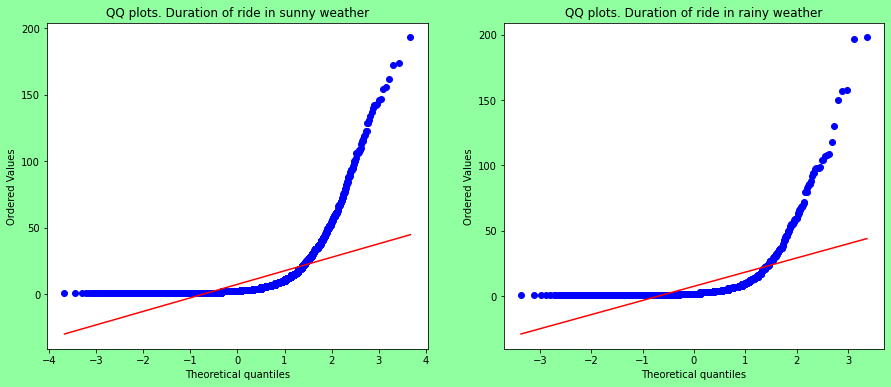

In [93]:
fig, ax = plt.subplots(figsize=(15, 6))
fig.patch.set_facecolor('xkcd:mint green')
ax1 = plt.subplot(121)
res = st.probplot(weekday['calls_count'], dist="norm", plot= plt)
plt.title("QQ plots. Duration of ride in sunny weather")

ax2 = plt.subplot(122)
res = st.probplot(weekend['calls_count'], dist="norm", plot= plt)
plt.title("QQ plots. Duration of ride in rainy weather")
plt.show()

As we can see in the QQ-plot, our data is far from a normal distribution and has serious outliers. In this case, we cannot use Student's t-test to test the hypothesis, since it is very susceptible to outliers. Let's use a non-parametric analog of Student's t-test (Mann_Whitney U-test), since it is less susceptible to outliers.

In [94]:
alpha = 0.05
results = st.mannwhitneyu(weekday['calls_count'], weekend['calls_count'])
 
print('p-value: ', results.pvalue)
 
if (results.pvalue < alpha):
    print("Null hypothesis rejected: the difference is statistically significant")
else:
    print("Failed to reject the null hypothesis: we can't make conclusions about the difference")

p-value:  0.06363637918170098
Failed to reject the null hypothesis: we can't make conclusions about the difference


<div class="alert alert-success">
QQ-plots? I am amazed :)
</div>

##### Conclusion: <br /> 
We cannot reject the null hypothesis that the number of missed calls on weekends and weekdays is different.

#### 5.2 Hypothese II. Clients of tariff plan "B" have more inefficient operators than clients of tariff plan "C".<a name="hypotheses_2"></a>

##### Hypothesis Null:
The observed share of inefficient operators among clients with tariff plan "B" is equal to the share of inefficient operators among clients with tariff plan "C".<br /> <br />
##### Hypothesis alternative: 
The observed share of inefficient operators among clients with tariff plan "B" isn't equal to the share of inefficient operators among clients with tariff plan "C". <br /><br />

Set alpha = 0.05, since we are evaluating a hypothesis for a business problem.

Since we will test hypotheses about the identity of the proportions, we will use the "Two-Proportions Z-Test"

Z = $\frac{(\hat{p}_{1} - \hat{p}_{2}) - 0}{\sqrt{\hat{p}(1-\hat{p}) (\frac{1}{{n}_{1}} + \frac{1}{{n}_{2}})}}$

In [95]:
operator_tarif = ( 
    operators_filtred.
    query('operator_id != 0')[['operator_id','tariff_plan']].
    drop_duplicates()
)

In [96]:
operators_metrics = operators_metrics.merge(operator_tarif, on='operator_id')

In [97]:
alpha = 0.05
def check_hypothesis(group_A, group_B,event):
    
    #total records
    enter_A = len(operators_metrics[operators_metrics.tariff_plan == group_A])
    enter_B = len(operators_metrics[operators_metrics.tariff_plan == group_B])

    #successful outcome
    exit_A  = len(operators_metrics.query('(tariff_plan == @group_A) & (effective == True)'))
    exit_B  = len(operators_metrics.query('(tariff_plan == @group_B) & (effective == True)'))
    
    #proportion
    p1 = exit_A / enter_A
    p2 = exit_B / enter_B
    
    #cumulative proportion
    p = (exit_A + exit_B) / (enter_A + enter_B)
    z_value = (p1 - p2) / (math.sqrt(p * (1 - p) * (1 / (enter_A)+ 1 / (enter_B))))
    
    distr = st.norm(0, 1) 
    
    p_value = (1 - distr.cdf(abs(z_value))) * 2
    print('In group {:} the {:} event occurred in {:} users, the share is {:0.2%}'.
          format(group_A,event,exit_A,p1))
    print('In group {:} the {:} event occurred in {:} users, the share is {:0.2%}'.
          format(group_B,event,exit_B,p2))
    
    print('p-value: {:.5f}'.format(p_value))
    if (p_value < alpha):
        print("Reject H0 for {:} event for groups {:} and {:}\n".
              format(event,group_A,group_B))
    else:
        print("Fail to Reject H0 for {:} event for groups {:} and {:}\n".
              format(event,group_A,group_B))  

In [98]:
check_hypothesis("B","C",'effective')

In group B the effective event occurred in 279 users, the share is 73.61%
In group C the effective event occurred in 267 users, the share is 70.63%
p-value: 0.36058
Fail to Reject H0 for effective event for groups B and C



##### Conclusion: <br />
After testing the hypothesis, we cannot reject the null hypothesis for the Effective-Non-effective operator proportion. We found that conversion rates were not statistically significant.

### Step 6. Prediction<a name="prediction"></a>

#### 6.1 Data preprocessing<a name="6_1"></a>

In [99]:
operators_prediction = operators_metrics
operators_prediction.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1058 entries, 0 to 1057
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   operator_id           1058 non-null   int64  
 1   sum_call_out          1058 non-null   float64
 2   sum_call_out_miss     1058 non-null   float64
 3   sum_call_in           1058 non-null   float64
 4   sum_call_in_miss      1058 non-null   float64
 5   sum_dur_out           1058 non-null   float64
 6   sum_dur_out_miss      1058 non-null   float64
 7   sum_dur_in            1058 non-null   float64
 8   sum_dur_in_miss       1058 non-null   float64
 9   count_case_out        1058 non-null   float64
 10  count_case_out_miss   1058 non-null   float64
 11  count_case_in         1058 non-null   float64
 12  count_case_in_miss    1058 non-null   float64
 13  share_in              1058 non-null   float64
 14  type                  1058 non-null   object 
 15  count_cases_max      

In [100]:
operators_prediction = operators_prediction.drop(['wait_time','total_calls_duration','count_cases_max','sum_dur_out_miss','sum_dur_in_miss','count_calls_day','count_out_calls_day','share_in_miss'], axis =1)

In [101]:
operators_prediction = pd.get_dummies(operators_prediction)

In [102]:
operators_prediction.describe().loc[['min','mean','std','max']].T

,min,mean,std,max
operator_id,879896.00,925246.69,22756.58,973286.00
sum_call_out,0.00,231.38,451.97,4849.00
sum_call_out_miss,0.00,178.07,385.79,3704.00
sum_call_in,0.00,84.87,284.93,4752.00
sum_call_in_miss,0.00,0.64,2.78,52.00
sum_dur_out,0.00,22261.16,44468.60,323488.00
sum_dur_in,0.00,8639.22,26671.99,353182.00
count_case_out,0.00,13.04,17.11,87.00
count_case_out_miss,0.00,11.17,15.25,82.00
count_case_in,0.00,11.08,16.61,93.00


#### 6.2 Let's compare the average values of characteristics in two groups: those who are considered ineffective operators and those who are considered effective.<a name="6_2"></a>

In [103]:
operators_prediction_effective = ( 
    operators_prediction.
    groupby('effective').
    mean().
    transpose().
    rename(columns={0:'False',1:'True'})
)
operators_prediction_effective

effective,False,True
operator_id,920260.41,927049.97
sum_call_out,96.53,280.15
sum_call_out_miss,65.09,218.92
sum_call_in,138.41,65.51
sum_call_in_miss,1.52,0.33
sum_dur_out,9539.20,26862.03
sum_dur_in,12833.13,7122.50
count_case_out,11.53,13.59
count_case_out_miss,9.01,11.96
count_case_in,14.16,9.96


Dividing the data into 2 groups (operators who do not work efficiently and those who work efficiently), we can draw the following conclusions:<br />

- Effective operators make 3 times more outgoing calls.
- Inefficient operators receive 3 times more incoming calls.
- Effective operators have 2.5 times longer outgoing calls.
- Effective operators have 2 times shorter incoming calls.
- The rest of the characteristics are distributed between these groups in approximately the same way.

#### 6.3 Correlation matrix between customer features<a name="matrix"></a>

In [104]:
operators_prediction_heatmap = operators_prediction.corr()  

Text(0.5, 50.09375, 'Features')

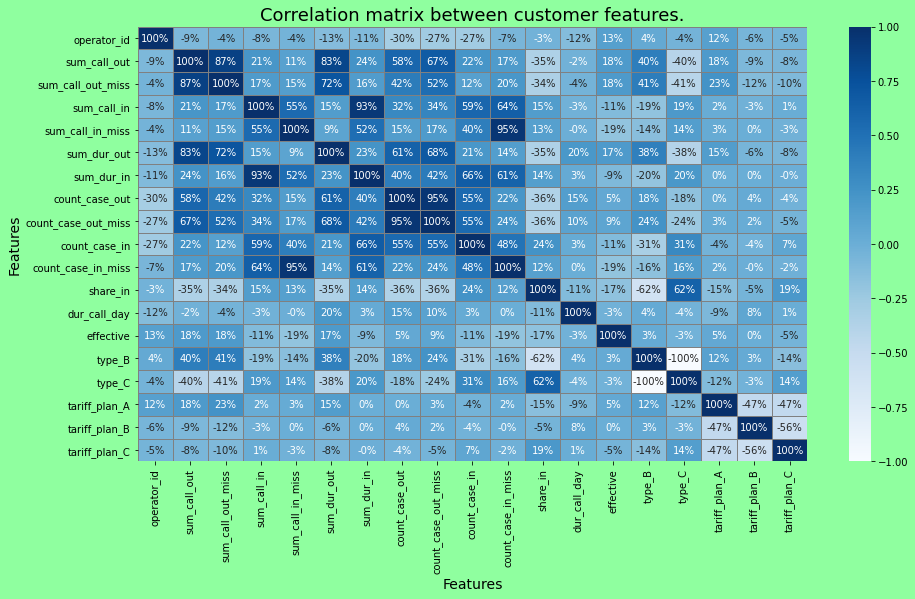

In [105]:
fig, ax = plt.subplots(figsize=(15, 8))
fig.patch.set_facecolor('xkcd:mint green')
plt.title('Correlation matrix between customer features.', fontsize=18)
    
sns.heatmap(operators_prediction_heatmap, 
            annot= True,
            fmt = '.0%',
            linewidths = 1,
            linecolor = 'grey',
            vmin = -1,
            vmax = 1,
            cmap = 'Blues',
            yticklabels = True,
           )
ax.set_ylabel('Features', fontsize=14)   
ax.set_xlabel('Features', fontsize=14)

As we can see, only five pairs of features have a strong correlation.
- 'type_B' and 'type_C'
- 'count_case_in_miss' and 'sum_call_in_miss'
- 'count_case_out' and 'count_case_out_miss'
- 'sum_call_in' and 'sum_dur_in'
- 'sum_call_out_miss' and 'sum_call_out'
<br /><br />
There is no need to remove highly correlated features for the "K-Means" algorithm. 

#### 6.4 Standardize the data and plot a dendrogram<a name="dendrogram"></a>

In [106]:
X = operators_prediction.drop('effective', axis = 1)
y = operators_prediction['effective']
X_train, X_test, y_train, y_test = train_test_split(X,y, 
                                                    test_size=0.2, 
                                                    random_state=0,
                                                    stratify=y
                                                   )

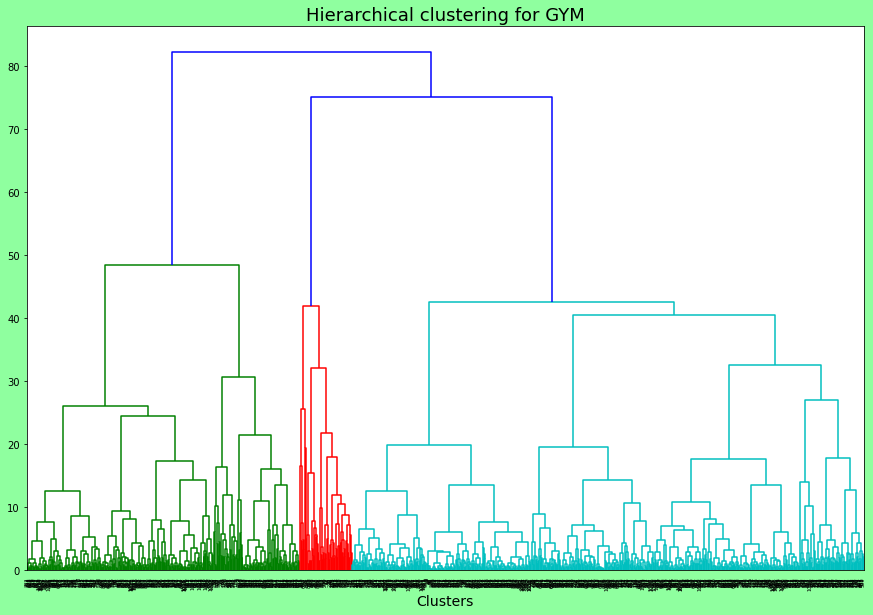

In [107]:
scaler = StandardScaler()
X_sc = scaler.fit_transform(X)
linked = linkage(X_sc, method = 'ward') 
# Build dendrogram
fig, ax = plt.subplots(figsize=(15, 10))
fig.patch.set_facecolor('xkcd:mint green')
dendrogram(linked, orientation='top')
plt.title('Hierarchical clustering for GYM', fontsize=18)
ax.set_xlabel('Clusters', fontsize=14)
plt.show() 

Conclusion:

As we can see from the dendrogram, the system offers us to divide clients into 3 clusters.

#### 6.5 Let's train the model on the train set with "K-means" algorithm.<a name="k_means"></a>

In [108]:
# define the k_means model with 3 clusters
km = KMeans(n_clusters = 3, random_state = 0)
labels = km.fit_predict(X_sc) 
# store cluster labels into the field of our dataset
operators_prediction['cluster'] = labels

##### Let's check how well the algorithm managed to divide clients into clusters.

In [109]:
print('Silhouette score is {:.2f}'.format(silhouette_score(X_sc, labels)))

Silhouette score is 0.27


The assessment of the quality of dividing clients into clusters is not high, which means that clients from one cluster are to some extent similar to clients from other clusters.

#### 6.6 The mean feature values for clusters.<a name="mean"></a>

In [110]:
operators_prediction.groupby(['cluster']).mean().reset_index().T

,0,1,2
cluster,0.00,1.00,2.00
operator_id,925653.18,914880.58,926669.54
sum_call_out,41.63,781.12,475.48
sum_call_out_miss,26.27,502.56,397.76
sum_call_in,47.75,786.18,6.89
sum_call_in_miss,0.38,5.79,0.06
sum_dur_out,4080.03,72704.67,46123.16
sum_dur_in,4712.23,81167.44,741.58
count_case_out,7.38,44.39,17.16
count_case_out_miss,5.29,40.71,16.11


Dividing clients into 3 clusters using the K-means algorithm, we can draw the following conclusions:<br /><br />
- Operators from clusters 0 and 2 are less likely to be ineffective than operators from cluster 1.
- Operators from cluster 2 specialize in outgoing calls, in our project we assigned them to type B
- Operators from cluster 0 make 10 times fewer outgoing calls than operators from cluster 2 and 20 times less than operators from cluster 1
- Operators from cluster 1 receive 100 times more incoming calls than operators from cluster 2 and 15 times more than operators from cluster 0
- Operators from cluster 2 have almost no missed incoming calls.
- Operators from cluster 1 make the longest calls, both incoming and outgoing.
- Operators from cluster 1 work the longest.

#### 6.7 Plot distributions of features for the clusters.<a name="distributions"></a>

In [111]:
numeric_data_list = ['sum_call_out',
                     'sum_call_in',
                     'share_in', 
                     'sum_call_in_miss',
                     'count_case_in',
                     ]

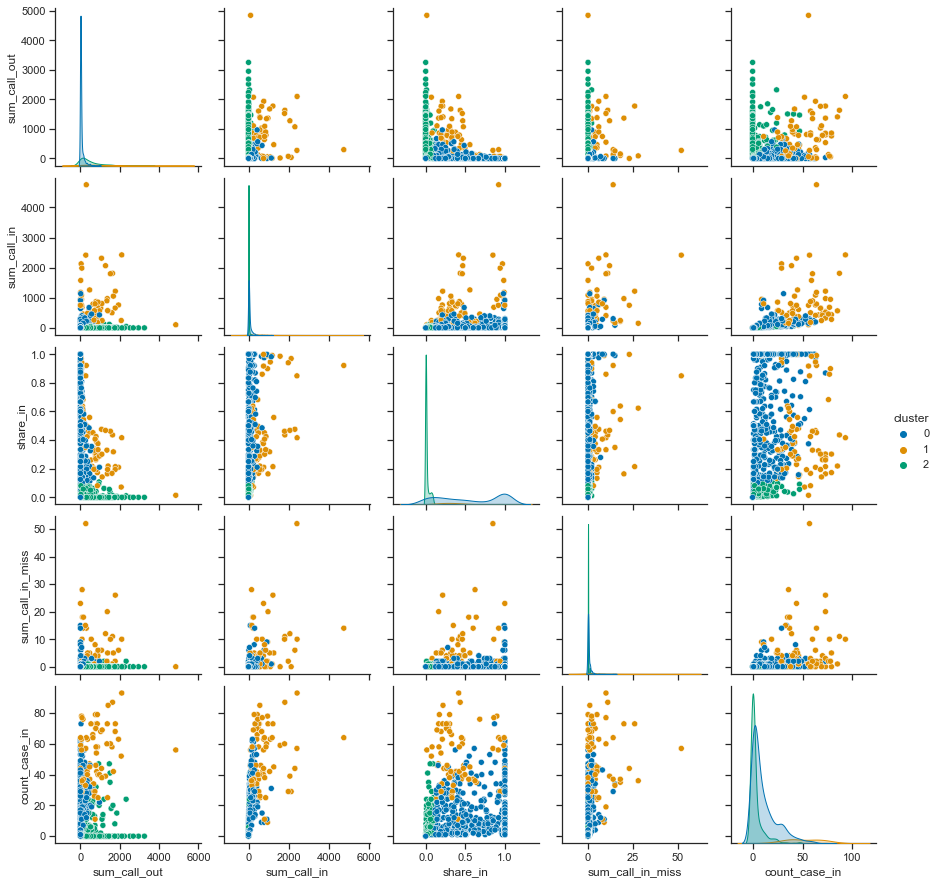

In [112]:
# warnings.simplefilter("ignore", UserWarning)

sns.set(style="ticks", color_codes=True)
g = sns.pairplot(operators_prediction, hue = 'cluster', palette = "colorblind",
                 vars =numeric_data_list)
plt.show()

We see that the clusters generally do not intersect and have their own pronounced features.

#### 6.8 Calculate the proportion of inefficient operators for each cluster<a name="calculate"></a>

In [113]:
cluster = (
    operators_prediction.query('effective == False').
    groupby('cluster').
    agg({'cluster':'count'}).
    rename(columns={'cluster':'churn'}).
    reset_index()
)
cluster['total'] = operators_prediction.groupby('cluster').agg({'cluster':'count'})
cluster['ratio_churn'] = cluster['churn'] / cluster['total']
cluster

,cluster,churn,total,ratio_churn
0,0,169,646,0.26
1,1,28,72,0.39
2,2,84,340,0.25


In [114]:
#let's built graph 
xasix_list = ['Cluster 0','Cluster 1','Cluster 2']

fig = go.Figure()
plot_bar(fig, xasix_list, cluster['ratio_churn'], "", 'green')

update_layout(fig, 'The proportion of inefficient operators for each cluster ', '')
fig.show()

##### Conclusion: <br />
As we can see, clusters 0 and 2 differ from the first cluster in the proportion of effective operators. Cluster 2 has the lowest share of inefficient operators (24.7%). In cluster 1, more than 40% of operators are ineffective.

### Step 7.  Conclusions and basic recommendations<a name="conclusions"></a>

#### 7.1 Overall conclusion.<a name="overall_conclusion"></a>

After analyzing the data, we came to the following conclusions: <br /> <br />
The number of clients is growing steadily.<br /><br />
Mainly companies employ from 2 to 6 operators, however, there are companies with more than 50 operators. It is clearly seen that companies with a large number of operators choose tariff plan A, while companies with a small number of operators choose tariff plan C. Most of the customers who use tariff plan C.<br /><br />
Most calls last less than 6 minutes.<br /><br />
Only 25% of calls are incoming, i.e. mainly clients use our service to outgoing calls.<br /><br />
The share of missed incoming calls is more than 43.5%, which is a rather bad indicator, in other words, more than 4 out of 10 customers do not get through to operators from the first call.<br /><br />
32% of operators make only outgoing calls, and only 3% of operators specialize in incoming calls.<br /><br />
I have set the following boundaries for inefficient operators:
- number of outgoing calls less than 11 per day (type B)
- number of missed calls more than 8 per day (type C)
- waiting time for an answer more than 19 seconds, for operators who receive more than one call per day. (type C)<br /><br />

We assessed the work of 27% of operators as ineffective. If administrators correct the data collection algorithm, then the number of ineffective operators may increase, since there is no data on missed calls from 75% of operators.<br /><br />
We tested 2 hypotheses and came to the conclusion that:
- We cannot reject the null hypothesis that the number of missed calls on weekends and weekdays is different.
- We cannot reject the null hypothesis for the Effective-Non-effective operator proportion. We found that conversion rates were not statistically significant.

#### 7.2 Recommendations.<a name="recommendations"></a>

We have determined that more than 43.5% of incoming calls are not handled by operators, which is the most important criterion for an operator's performance. Since a client who cannot get through to the operator will place an order in another company. Supervisors should monitor this metric very carefully.<br /><br />

Unfortunately, the data is collected incorrectly and in 99% of cases we do not know which operator did not answer the call. It is very important to fix the data collection mechanism.
<br /><br />
When the data is collected correctly, it will be necessary to analyze it again and determine the percentage of missed calls for effective operators.
<br /><br />
You also need to draw the attention of supervisors to the number of outgoing calls. On average, operators make 2 to 6 outgoing calls, which is very few. The operator must make 40-60 successful calls per day

##### List of references.<a name="references"></a>
1. [How to Communicate the Value of the Call Center KPI](https://www.lightico.com/blog/call-center-kpis/)
2. [Plotly Python Open Source Graphing Library](https://plotly.com/python/#fundamentals)
3. [Basic Statistics You NEED to Know for Data Science](https://towardsdatascience.com/basic-statistics-you-need-to-know-for-data-science-1fdd290f59b5)
4. [The most used probability distributions in Data Science](https://towardsdatascience.com/the-most-used-probability-distributions-in-data-science-5b3c11d34bfe)
5. [Lecture 35: Finding Clusters in Graphs](https://ocw.mit.edu/courses/mathematics/18-065-matrix-methods-in-data-analysis-signal-processing-and-machine-learning-spring-2018/video-lectures/lecture-35-finding-clusters-in-graphs-second-project-handwriting/)
6. [Chart: QQ-Plot](https://edav.info/qqplot.html)
7. [Using Panda’s “transform” and “apply” to deal with missing data on a group level](https://towardsdatascience.com/using-pandas-transform-and-apply-to-deal-with-missing-data-on-a-group-level-cb6ccf060531)


Dashboard<a name="dashboard"></a>: [link](https://public.tableau.com/profile/anton4143#!/vizhome/Dashboard_CallMeMaybeV1/Dashboard_CallMeMaybe?publish=yes) 

Presentation:<a name="presentation"></a>: [link](https://docs.google.com/presentation/d/1Rc-QH3WyXPb-uqdrmecH97fvN-_oDdpVTjmSO0d9XAI/edit?usp=sharing)